<a href="https://colab.research.google.com/github/anirudh217sharma/Retail-Analytics/blob/master/Notebook/Retail_analytics.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<b>Final Project: Retail Shop Case study<b>

**RETAIl IN DETAIL**

NetID1: br17<br>
NetID2: ashar29<br>
NetID1: anunays2<br>


In [0]:
####Importing all the packages as necessary
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime
from scipy.stats.mstats import winsorize
%matplotlib inline

import plotly
from plotly import __version__
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
print(__version__) # requires version >= 1.9.0
import plotly.graph_objects as go
import cufflinks as cf
cf.go_offline()

def enable_plotly_in_cell():
  import IPython
  from plotly.offline import init_notebook_mode
  display(IPython.core.display.HTML('''<script src="/static/components/requirejs/require.js"></script>'''))
  init_notebook_mode(connected=False)

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


4.4.1


In [0]:
########Uploading the necessary files - Customer, Product category and Transactions
from google.colab import files
upload =files.upload()
upload =files.upload()
upload =files.upload()

Saving Customer - Copy.csv to Customer - Copy.csv


Saving prod_cat_info.csv to prod_cat_info.csv


Saving Transactions3.csv to Transactions3.csv


In [0]:
##############Reading the files from the stored data#######
customer=pd.read_csv('Customer - Copy.csv')
prod_cat=pd.read_csv('prod_cat_info.csv')
transaction=pd.read_csv('Transactions3.csv')
transaction=transaction.drop_duplicates()
transaction=transaction[transaction['Qty']>0]  ###Removing the negative quantity from the data as it is junk
len(transaction)
transaction.head()

,transaction_id,cust_id,tran_date,Date,Concat,prod_subcat_code,prod_cat_code,Qty,Rate,Tax,total_amt,Store_type,Week,Year,Week_no
0,29258453508,270384,20-02-2014,2/20/2014,201402,5,3,5,1497,785.925,8270.925,e-Shop,8,2014,201408
1,25455265351,267750,20-02-2014,2/20/2014,201402,12,6,3,1360,428.400,4508.400,e-Shop,8,2014,201408
2,1571002198,275023,20-02-2014,2/20/2014,201402,6,5,4,587,246.540,2594.540,e-Shop,8,2014,201408
3,36554696014,269345,20-02-2014,2/20/2014,201402,3,5,3,1253,394.695,4153.695,e-Shop,8,2014,201408
4,56814940239,268799,20-02-2014,2/20/2014,201402,7,5,5,368,193.200,2033.200,e-Shop,8,2014,201408


In [0]:
##Changing the data column into date format
transaction['Date']=pd.to_datetime(transaction['Date'], format='%m/%d/%Y')
transaction['year']=pd.DatetimeIndex(transaction['Date']).year.astype('str')
transaction['Concat']=transaction['Concat'].astype('str')  #using an alternate date for plotting graphs
len(transaction['Concat'].unique())
transaction.columns

Index(['transaction_id', 'cust_id', 'tran_date', 'Date', 'Concat',
       'prod_subcat_code', 'prod_cat_code', 'Qty', 'Rate', 'Tax', 'total_amt',
       'Store_type', 'Week', 'Year', 'Week_no', 'year'],
      dtype='object')

<b>Exploratory Data Analysis

In [0]:
####Merging all the datasets to form the master table 
df=pd.merge(transaction,customer,how='inner',left_on='cust_id',right_on='customer_Id')
master_df=pd.merge(df,prod_cat,how='left',left_on=['prod_cat_code','prod_subcat_code'],right_on=['prod_cat_code' ,'prod_sub_cat_code'])
master_df['Concat']=master_df['Concat'].astype('str')

In [0]:
master_df.head()

,transaction_id,cust_id,tran_date,Date,Concat,prod_subcat_code,prod_cat_code,Qty,Rate,Tax,total_amt,Store_type,Week,Year,Week_no,year,customer_Id,DOB_old,DOB,Gender,city_code,prod_cat,prod_sub_cat_code,prod_subcat
0,29258453508,270384,20-02-2014,2014-02-20,201402,5,3,5,1497,785.925,8270.925,e-Shop,8,2014,201408,2014,270384,11/5/1973,11/5/1973,F,8.0,Electronics,5,Computers
1,92734514344,270384,26-10-2013,2013-10-26,201310,1,4,2,1362,286.020,3010.020,TeleShop,43,2013,201343,2013,270384,11/5/1973,11/5/1973,F,8.0,Bags,1,Mens
2,865952996,270384,6/8/2013,2013-06-08,201306,12,6,2,86,18.060,190.060,MBR,23,2013,201323,2013,270384,11/5/1973,11/5/1973,F,8.0,Home and kitchen,12,Tools
3,4116651679,270384,6/8/2013,2013-06-08,201306,6,5,1,1343,141.015,1484.015,TeleShop,23,2013,201323,2013,270384,11/5/1973,11/5/1973,F,8.0,Books,6,DIY
4,31964323792,270384,25-06-2013,2013-06-25,201306,1,4,5,487,255.675,2690.675,TeleShop,26,2013,201326,2013,270384,11/5/1973,11/5/1973,F,8.0,Bags,1,Mens


<b>Now we have the master df which contains all the information so we can move ahead with the exploratory data analysis

In [0]:
# Checking for null values in the dataframe
len(master_df.isnull().values[master_df.isnull().values==True])
print(f'There are only {len(master_df.isnull().values[master_df.isnull().values==True])} missing values in the dataset')
print('We can also visualize the percentage of missing values this via missing map')

There are only 16 missing values in the dataset
We can also visualize the percentage of missing values this via missing map


In [0]:
#######Total NULL values 
master_df.isnull().sum()

transaction_id       0
cust_id              0
tran_date            0
Date                 0
Concat               0
prod_subcat_code     0
prod_cat_code        0
Qty                  0
Rate                 0
Tax                  0
total_amt            0
Store_type           0
Week                 0
Year                 0
Week_no              0
year                 0
customer_Id          0
DOB_old              0
DOB                  0
Gender               8
city_code            8
prod_cat             0
prod_sub_cat_code    0
prod_subcat          0
dtype: int64

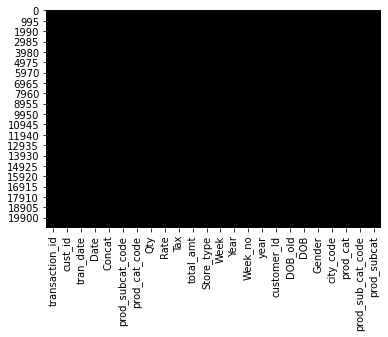

In [0]:
sns.heatmap(master_df.isnull(), cbar=False,cmap=['black','yellow'])
##where the yellow color represent the missing values and the black is where there are some values
##As wecan see they negligible missing values in the dataset and thus can be ignored
master_df.dropna(inplace=True)

In [0]:
master_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 20860 entries, 0 to 20875
Data columns (total 24 columns):
 #   Column             Non-Null Count  Dtype         
---  ------             --------------  -----         
 0   transaction_id     20860 non-null  int64         
 1   cust_id            20860 non-null  int64         
 2   tran_date          20860 non-null  object        
 3   Date               20860 non-null  datetime64[ns]
 4   Concat             20860 non-null  object        
 5   prod_subcat_code   20860 non-null  int64         
 6   prod_cat_code      20860 non-null  int64         
 7   Qty                20860 non-null  int64         
 8   Rate               20860 non-null  int64         
 9   Tax                20860 non-null  float64       
 10  total_amt          20860 non-null  float64       
 11  Store_type         20860 non-null  object        
 12  Week               20860 non-null  int64         
 13  Year               20860 non-null  int64         
 14  Week_n

In [0]:
##Creating two additional columns for date##
master_df['Day of Week'] =master_df['Date'].dt.day_name()
master_df['Month'] =master_df['Date'].dt.month

<b> Time series trends </b>

<b> Monthly sales Across Time <b>

Text(0.5, 1.0, 'Distribution of Sales Across Months')

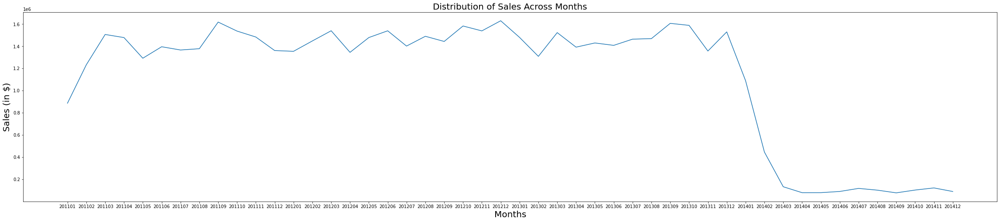

In [0]:
monthly_df=master_df.groupby(['Concat'])['total_amt'].sum().to_frame().reset_index()
fig, ax = plt.subplots()
fig.set_size_inches(40, 8)
plt.plot('Concat','total_amt',data=monthly_df)
sns.set_style("dark")
plt.xlabel('Months',fontsize=20)
plt.ylabel('Sales (in $)',fontsize=20)
plt.title('Distribution of Sales Across Months',fontsize=20)

<b>Monthly sales per store type across time<b>

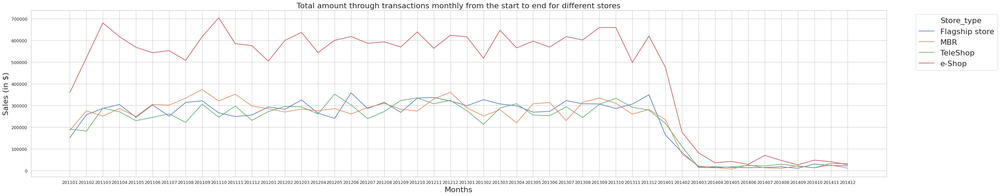

In [0]:
plt.figure(num=None, figsize=(40, 8), dpi=80, facecolor='w', edgecolor='k')
sns.set(style="whitegrid")
fig.set_size_inches(40, 8)
monthlystore_df=master_df.groupby(['Store_type','Concat'])['total_amt'].sum().to_frame().reset_index()
sns.lineplot('Concat','total_amt',data=monthlystore_df,hue='Store_type') 
plt.xlabel('Months',fontsize=20)
plt.ylabel('Sales (in $)',fontsize=20)
plt.title('Total amount through transactions monthly from the start to end for different stores',fontsize=20)
plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1),fontsize=20)

It can be seen that total transactions for e-shop is much higher than the other three stores across time while the other three stores

<b> Monthly Analysis  order </b>

<b> Weekly Analysis </b>

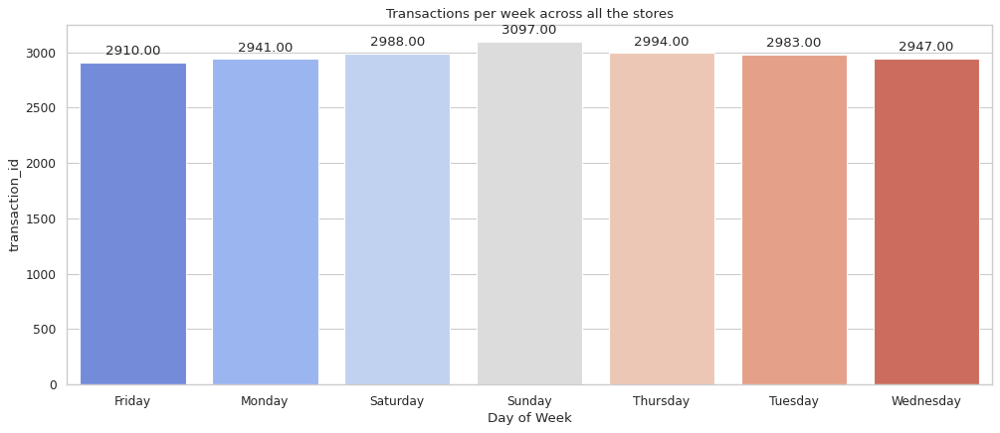

In [0]:
plt.figure(num=None, figsize=(15, 6), dpi=80, facecolor='w', edgecolor='k')
sns.set(style="whitegrid")
grouped_values=master_df.groupby(['Day of Week']).count().reset_index()
g=sns.barplot(x='Day of Week',y='transaction_id',data=grouped_values,palette='coolwarm')

plt.title('Transactions per week across all the stores')
for p in g.patches:
  g.annotate(format(p.get_height(), '.2f'), (p.get_x() + p.get_width() / 2., p.get_height()), ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points')

There is negligible difference between the number of orders per day of the week and almost identical number of orders are sold on each day of the week

Teleshop -to buy goods by telephone or via the internet.

A flagship store is the most important store in a chain, often with the largest volume of sales, or the most up-to-date formats or layouts. It is usual that the opening of a flagship store marks the first development of a retail store portfolio within a luxury fashion retailer's most important foreign markets.

An e-shop is an online business that sells a variety of goods and services. E-shops are business-to-consumer oriented. They are just like a retail store but instead of having a physical location, its location is on the internet

The term "brick-and-mortar" refers to a traditional street-side business that offers products and services to its customers face-to-face in an office or store that the business owns or rents. The local grocery store and the corner bank are examples of brick-and-mortar companies


As seen through the time series data for eachstore E-shop should produce a higher transaction amount as compared to the other three stores ,
lets plot a bar graph to see that

Text(0.5, 1.0, 'Total unique transactions for different Store Types')

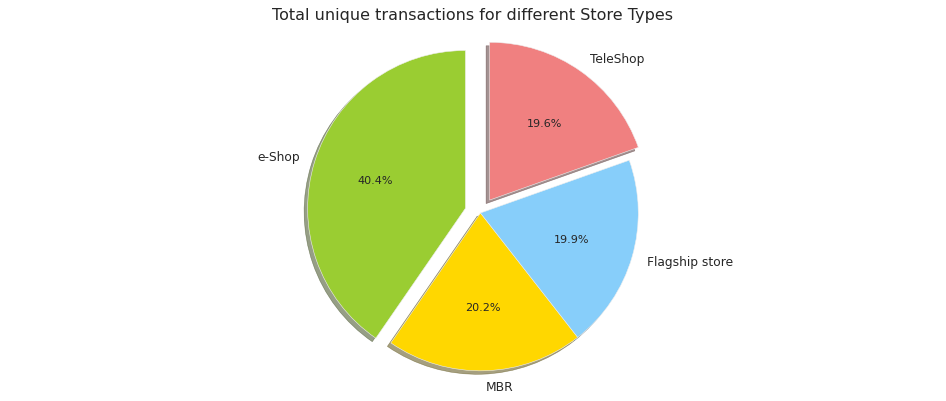

In [0]:
plt.figure(num=None, figsize=(15, 6), dpi=80, facecolor='w', edgecolor='k')
plt.style.use('ggplot')
labels = master_df['Store_type'].value_counts().index
sizes = master_df['Store_type'].value_counts().values
explode = (0.1, 0.0, 0.0, 0.1)  # only "explode" the 2nd and 3rd slices (i.e. 'Hogs')
colors = ['yellowgreen', 'gold', 'lightskyblue', 'lightcoral']
plt.pie(sizes, explode=explode, labels=labels, autopct='%1.1f%%',
        shadow=True, startangle=90 ,colors=colors)
plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
plt.title("Total unique transactions for different Store Types")

We can see that more than <b> 60% </b> of the transactions are for e-shop and Teleshops which indicated the shift in the mindset of people earlier this decade as this was the time when big giants such as Amazon and other E-commerce websites

As we can see that total amount of transactions for E-shop is approximately twice as compared to the other store types

<b> Product Categories </b>

Text(0.5, 1.0, 'Total unique transactions for different product categories')

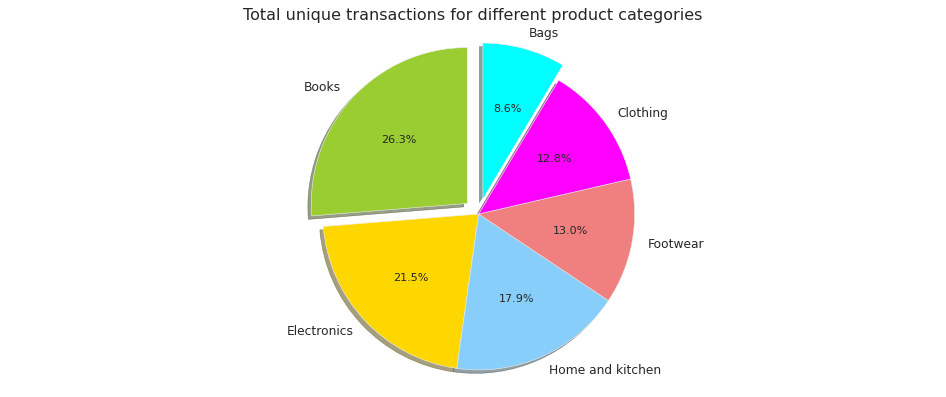

In [0]:
plt.figure(num=None, figsize=(15, 6), dpi=80, facecolor='w', edgecolor='k')
plt.style.use('ggplot')
labels = master_df['prod_cat'].value_counts().index
sizes = master_df['prod_cat'].value_counts().values
explode = (0.1, 0.0, 0.0, 0.0,0.0,0.1)  # only "explode" the 2nd and 3rd slices (i.e. 'Hogs')
colors = ['yellowgreen', 'gold', 'lightskyblue', 'lightcoral','magenta','cyan']
plt.pie(sizes, explode=explode, labels=labels, autopct='%1.1f%%',
        shadow=True, startangle=90 ,colors=colors)
plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
plt.title("Total unique transactions for different product categories")

Books have the highest number of transactions and the second one is electronics , the lowest is bags

In [0]:
# master_df.rename(columns={'product_category':'product category', 'total_amt': 'Total sales amount'},inplace=True)
########Purchase behavior by category, age and gender
plt.figure(figsize=(30,10))
sns.set(style="whitegrid")
df2=master_df.groupby(['prod_cat','Age_group','Gender']).sum()['total_amt'].reset_index()
df2.rename(columns={'prod_cat':'product category','total_amt':'Total sales amount'},inplace=True)
g=sns.catplot(x="product category", y="Total sales amount",hue="Age_group", col="Gender",data=df2, kind="bar")
g.set_xticklabels(rotation=30)


KeyError: ignored

<Figure size 2160x720 with 0 Axes>

Text(0, 0.5, 'Sales (in $)')

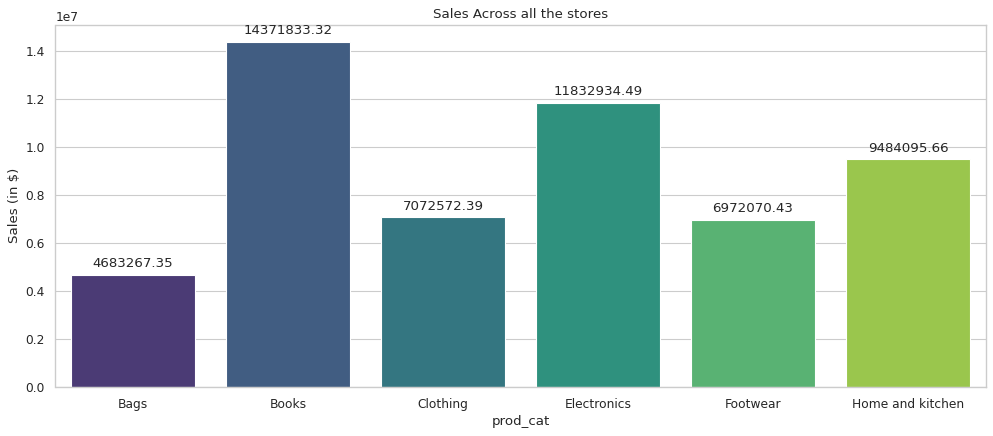

In [0]:
plt.figure(num=None, figsize=(15, 6), dpi=80, facecolor='w', edgecolor='k')
sns.set(style="whitegrid")
df2=master_df.groupby(['prod_cat']).sum()['total_amt'].reset_index()
g=sns.barplot(x='prod_cat',y='total_amt',data=df2,palette='viridis')
plt.title('Sales Across all the stores')
for p in g.patches:
  g.annotate(format(p.get_height(), '.2f'), (p.get_x() + p.get_width() / 2., p.get_height()), ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points')
plt.ylabel("Sales (in $)")  

An interesting thing to note here is that Books were responsible for the maximum transaction amount even higher than electronics and the lowest conribution is acoounted by bags.

From the above analysis for both the store types and product categories we can see that the number of unique transactions are positevely correlated to the amount of transaction produced , which is kind of expected

<b>Distribution of transactions amounts

In [0]:
enable_plotly_in_cell()
master_df['total_amt'].iplot(kind='hist',bins=25)

<b> Correlation plot </b>

<b>Gender and age analyisis<b>

In [0]:
# master_df['DOB'] = master_df['DOB'].apply(lambda x: datetime.strptime(x, '%d-%m-%Y') if '-' in x else datetime.strptime(x, '%d/%m/%Y'))
master_df['DOB'] = pd.to_datetime(master_df['DOB'], format = '%m/%d/%Y')
master_df['Age']=master_df['Date']-master_df['DOB']
master_df['Age']=master_df['Age'].apply(lambda x:round(int(str(x).split()[0])/365,0))
master_df['Age_group']=master_df['Age'].apply(lambda x: 'Young' if (18<=x<=25) else ('Middle' if (25<x<=35) else 'Old'))

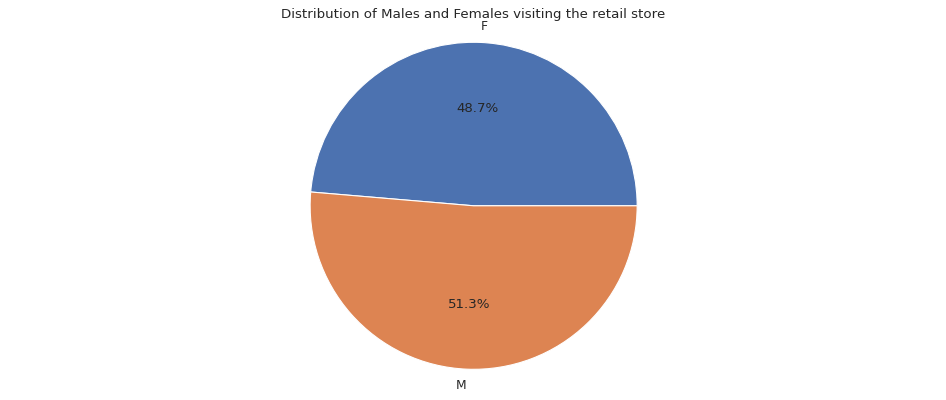

In [0]:
plt.figure(num=None, figsize=(15, 6), dpi=80, facecolor='w', edgecolor='k')
Gender_count=master_df.groupby(['Gender'])['customer_Id'].nunique().to_frame().reset_index()

plt.pie(Gender_count['customer_Id'],labels=Gender_count['Gender'],autopct='%1.1f%%')
plt.title("Distribution of Males and Females visiting the retail store")
plt.axis('equal') 
plt.show()

There are more male customers then female customers but the ratio is not different

In [0]:
#####Removing the 2014 data due to its discrepancy
master_df_sub=master_df[master_df['Date']<='2013-12-31']

<b>Problem1 - Customer Segmentation

In [0]:
######Clustering approach
df3_clustering=master_df_sub.groupby('cust_id').agg({'total_amt':'sum','Qty':'sum','transaction_id':'nunique','Age':'mean'}).reset_index()
df3_clustering['Sales/Trans']=df3_clustering['total_amt']/df3_clustering['transaction_id']
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
# scaler.fit(df3_clustering[["Sales/Trans","Qty","Age"]])
# x=scaler.transform(df3_clustering[["Sales/Trans","Qty","transaction_id"]])
x=scaler.fit_transform(df3_clustering[["Sales/Trans","Qty","transaction_id"]])  ###Scaling all variables to treat all the importance equally
x=pd.DataFrame(x)
cluster_results=x
x

,0,1,2
0,0.261301,0.243243,0.3
1,0.219763,0.243243,0.2
2,0.484164,0.729730,0.6
3,0.173998,0.189189,0.3
4,0.322656,0.756757,0.9
...,...,...,...
5464,0.406996,0.297297,0.3
5465,0.138803,0.216216,0.2
5466,0.298070,0.108108,0.1
5467,0.220955,0.216216,0.1


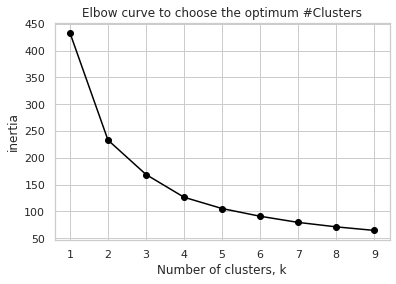

In [0]:
from sklearn.cluster import KMeans
# Empty list to store Sum of squared distances of samples to their closest cluster centre
inertias = []
for k in range(1,10):
    # Create a KMeans instance with k clusters: model
    model = KMeans(n_clusters=k)
    # Fit model to samples
    #model.fit(pca_1.iloc[:,:3])
    model.fit(cluster_results)
    # Append the inertia to the list of inertias
    inertias.append(model.inertia_)
plt.plot(range(1,10), inertias, '-o', color='black')
plt.xlabel('Number of clusters, k')
plt.ylabel('inertia')
plt.title('Elbow curve to choose the optimum #Clusters')
plt.xticks(range(1,10))
plt.show()

In [0]:
###Fitting the algorithm to the data
kmeans = KMeans(n_clusters=3, init='k-means++', max_iter=300, n_init=10, random_state=0)
pred_y = kmeans.fit_predict(cluster_results)
pred_y=pd.DataFrame(pred_y,columns=['Cluster'])
df3_clustering1 = pd.concat([df3_clustering,pred_y], axis=1)
# df3_clustering1=pd.merge(master_df,df3_clustering1,left_on='customer_Id',right_on='cust_id',how='left')
kmeans.cluster_centers_

array([[0.31111579, 0.4521057 , 0.47238151],
       [0.45973727, 0.23684302, 0.18153153],
       [0.19253984, 0.14834236, 0.1605621 ]])

In [0]:
############Saving the results in a file###################
df3_clustering1.to_excel("cluster_results2.xlsx")

In [0]:
#######3D package imported######
from mpl_toolkits.mplot3d import Axes3D

In [0]:
# fig = plt.figure(figsize=(15,8))
# ax = fig.add_subplot(111, projection='3d')
# x=['yellowgreen', 'gold', 'lightskyblue']
# for i,num in enumerate(x):
#   plt.scatter(df3_clustering1[df3_clustering1["Cluster"]==i]["total_amt_x"],df3_clustering1[df3_clustering1["Cluster"]==i]["Qty_x"],df3_clustering1[df3_clustering1["Cluster"]==i]["transaction_id_x"],label='Cluster'+str(i), c =num)
#   plt.legend(loc='upper left')
# ax.set_xlabel('Total Amount')
# ax.set_ylabel('Quantity')
# ax.set_zlabel('Number of Transactions')
# plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
# plt.title('K-mean clustering for customer segementation : K=3')
# plt.tight_layout()

In [0]:
df3_clustering1.head()

,cust_id,total_amt,Qty,transaction_id,Age,Sales/Trans,Cluster
0,266783,8952.710,10,4,39.000000,2238.177500,2
1,266784,5694.065,10,3,20.666667,1898.021667,2
2,266785,28442.700,28,7,27.000000,4063.242857,0
3,266788,6092.970,8,4,40.750000,1523.242500,2
4,266794,27406.210,29,10,40.900000,2740.621000,0


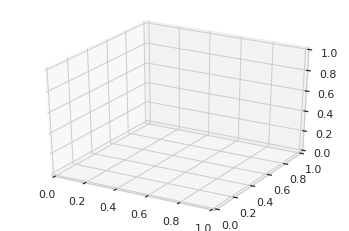

In [0]:
from mpl_toolkits import mplot3d

import numpy as np
import matplotlib.pyplot as plt

fig = plt.figure()
ax = plt.axes(projection="3d")

plt.show()

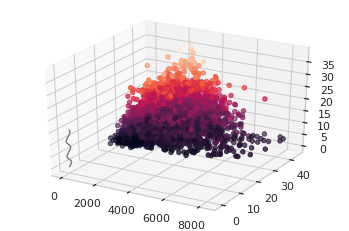

In [0]:
fig = plt.figure()
ax = plt.axes(projection="3d")

z_line = np.linspace(0, 15, 1000)
x_line = np.cos(z_line)
y_line = np.sin(z_line)
ax.plot3D(x_line, y_line, z_line, 'gray')

z_points = df3_clustering1['Qty']
x_points = df3_clustering1['Sales/Trans']
y_points = df3_clustering1['Age']
ax.scatter3D(x_points, y_points, z_points, c=z_points);

plt.show()

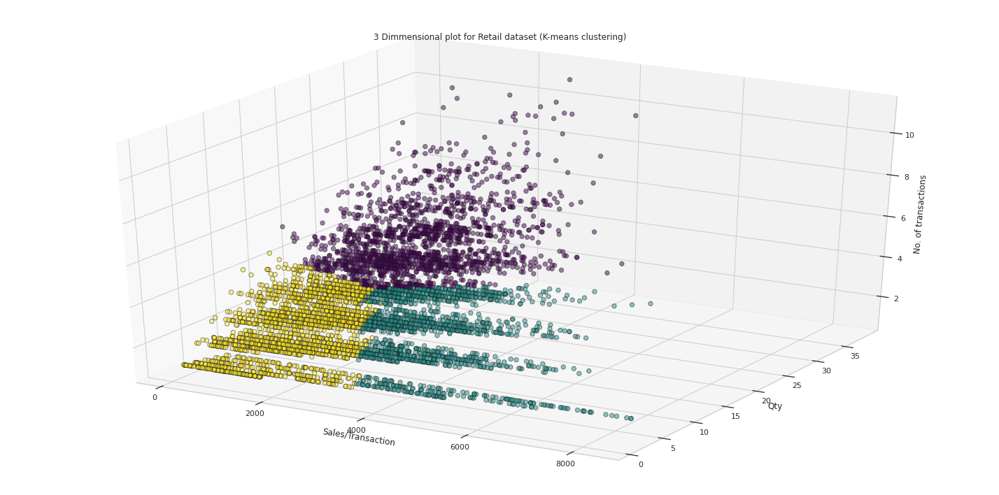

In [0]:
##########3D view of the clusters############
fig = plt.figure(figsize=(20,10))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(df3_clustering1["Sales/Trans"],df3_clustering1["Qty"],df3_clustering1["transaction_id"], 
            c=df3_clustering1['Cluster'], cmap='viridis',
            edgecolor='k', s=40, alpha = 0.5)
ax.set_xlabel('Sales/Transaction')
ax.set_ylabel('Qty')
ax.set_zlabel('No. of transactions')
ax.set_title('3 Dimmensional plot for Retail dataset (K-means clustering)')
plt.tight_layout()

In [0]:
#######Interactive view to get cluster view - Rotate to get a better picture#######
enable_plotly_in_cell()
import plotly.express as px
df = df3_clustering1
df=df.rename(columns={'transaction_id': '#transactions'})
# df=df.rename(columns={'', 'Transactions'})
df.head()
fig = px.scatter_3d(df, x='Sales/Trans', y='Qty', z='#transactions',
             color='Cluster', opacity=0.2)

fig.show()

In [0]:
# fig = plt.figure()
# ax = fig.add_subplot(111)
# scatter = ax.scatter(df3_clustering1["Sales/Trans"],df3_clustering1["total_amt"],
#                      c=df3_clustering1['Cluster'],s=50)
# ax.set_title('K-Means Clustering')
# ax.set_xlabel('GDP per Capita')
# ax.set_ylabel('Corruption')
# plt.colorbar(scatter)

<b>Problem2 - Sales Forecasting

In [0]:
####code for forecasting###############################
master_df.head()

,transaction_id,cust_id,tran_date,Date,Concat,prod_subcat_code,prod_cat_code,Qty,Rate,Tax,total_amt,Store_type,Week,Year,Week_no,year,customer_Id,DOB_old,DOB,Gender,city_code,prod_cat,prod_sub_cat_code,prod_subcat,Day of Week,Month,Age,Age_group
0,29258453508,270384,20-02-2014,2014-02-20,201402,5,3,5,1497,785.925,8270.925,e-Shop,8,2014,201408,2014,270384,11/5/1973,1973-11-05,F,8.0,Electronics,5,Computers,Thursday,2,40.0,Old
1,92734514344,270384,26-10-2013,2013-10-26,201310,1,4,2,1362,286.020,3010.020,TeleShop,43,2013,201343,2013,270384,11/5/1973,1973-11-05,F,8.0,Bags,1,Mens,Saturday,10,40.0,Old
2,865952996,270384,6/8/2013,2013-06-08,201306,12,6,2,86,18.060,190.060,MBR,23,2013,201323,2013,270384,11/5/1973,1973-11-05,F,8.0,Home and kitchen,12,Tools,Saturday,6,40.0,Old
3,4116651679,270384,6/8/2013,2013-06-08,201306,6,5,1,1343,141.015,1484.015,TeleShop,23,2013,201323,2013,270384,11/5/1973,1973-11-05,F,8.0,Books,6,DIY,Saturday,6,40.0,Old
4,31964323792,270384,25-06-2013,2013-06-25,201306,1,4,5,487,255.675,2690.675,TeleShop,26,2013,201326,2013,270384,11/5/1973,1973-11-05,F,8.0,Bags,1,Mens,Tuesday,6,40.0,Old


In [0]:
master_df['total_amt']=winsorize(master_df['total_amt'], limits=0.05)
master_df['Qty']=winsorize(master_df['Qty'], limits=0.1)
master_df['Week']=master_df['Date'].dt.week
master_df['Year']=master_df['Date'].dt.year
master_df['Week_no']=np.where(master_df['Week']<10,master_df['Year'].astype('str')+"0"+master_df['Week'].astype('str'),master_df['Year'].astype('str')+master_df['Week'].astype('str'))

In [0]:
###############Aggregating the data at a weekly level######
master_df1=master_df.groupby(['Week_no','Concat']).agg({'total_amt':'sum','Qty':'sum','transaction_id':'nunique','customer_Id':'nunique'}).reset_index().sort_values(by='Concat')
master_df1['Concat']=master_df1['Concat'].astype('int')

In [0]:
# master_df1['eshop_sales']=master_df.groupby('Concat').apply(lambda x : x['total_amt'][x['Store_type']=='e-Shop'].sum()).reset_index(level=0,drop=True)
# master_df1['eshop_trans']=master_df.groupby('Concat').apply(lambda x : x['transaction_id'][x['Store_type']=='e-Shop'].nunique()).reset_index(level=0,drop=True)
master_df1=master_df1[master_df1['Concat']<=201312]
master_df1


,Week_no,Concat,total_amt,Qty,transaction_id,customer_Id
0,201101,201101,340779.790,396,131,130
1,201102,201101,128524.760,138,46,46
2,201104,201101,300546.740,349,117,116
3,201105,201101,47414.445,61,19,19
59,201152,201101,59834.645,72,23,23
...,...,...,...,...,...,...
182,201348,201312,39419.770,36,16,16
183,201349,201312,370883.305,388,129,129
184,201350,201312,284857.950,341,115,113
185,201351,201312,374263.500,433,147,145


In [0]:
##################Training and Testing###############
X_train=master_df1[master_df1['Concat']<=201304].drop(columns=['total_amt','Concat','Week_no'])
y_train=master_df1[master_df1['Concat']<=201304]['total_amt']
X_test=master_df1[master_df1['Concat']>201304].drop(columns=['total_amt','Concat','Week_no'])
y_test=master_df1[master_df1['Concat']>201304]['total_amt']

In [0]:
#############Importing packages##############
from sklearn.model_selection import train_test_split 
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score
from sklearn import metrics

In [0]:
###########Fitting linear regression and calculating respective metrics in the following code#################
regressor = LinearRegression()  
regressor.fit(X_train, y_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

In [0]:
print(regressor.intercept_)

-5407.79466542654


In [0]:
print(regressor.coef_)

[ 890.5707283   452.58272118 -510.75019464]


In [0]:
regressor.score(X_train, y_train)

0.9820066472454926

In [0]:
y_pred = regressor.predict(X_test)

In [0]:
# df = pd.DataFrame({'Actual': Y_test.flatten(), 'Predicted': y_pred.flatten()})
df = pd.DataFrame({'Actual': y_test, 'Predicted': y_pred})
df

,Actual,Predicted
148,343969.925,350819.652672
150,252260.450,234863.816365
146,290392.895,283263.531687
147,271790.220,299486.365843
149,249924.480,271453.442325
155,298588.680,309896.971929
154,311163.580,321634.299104
153,314391.285,347389.925684
152,352984.515,348765.732474
151,113285.705,108550.451269


In [0]:
print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, y_pred)) 
print('Mean Absolute Error:', metrics.mean_squared_error(y_test, y_pred)) 
print("The mean absolute % error is {}%".format(round(np.mean(np.abs(y_pred- y_test.values)/np.abs(y_test.values))*100,2)))

Mean Absolute Error: 13291.364671668947
Mean Absolute Error: 281578338.01807624
The mean absolute % error is 5.71%


In [0]:
r2_score(y_test, y_pred)

0.9720037685087973

In [0]:
coeff_df = pd.DataFrame(regressor.coef_, X_train.columns, columns=['Coefficient'])  
coeff_df

,Coefficient
Qty,890.570728
transaction_id,452.582721
customer_Id,-510.750195


In [0]:
#############Building a correlation matrix###############
master_df1.rename(columns={'transaction_id':'total_transactions','customer_Id':'total_customers'},inplace=True)
master_df1.corr()
corr = master_df1.drop(columns=['Concat']).corr()
corr.style.background_gradient(cmap='coolwarm')

,total_amt,Qty,total_transactions,total_customers
total_amt,1.000000,0.989942,0.982760,0.982477
Qty,0.989942,1.000000,0.992989,0.992769
total_transactions,0.982760,0.992989,1.000000,0.999666
total_customers,0.982477,0.992769,0.999666,1.000000


#############We cant use linear regression for this data as it doesn't satisfy any linear assumption:
The dependent variable is not normally distributed
The autocorrelation would exist in a time series while it is 0 in LinearRegression

Time series modelling

In [0]:
master_df1['Week_no']=master_df1['Week_no'].astype(str)
master_df1.dtypes

Week_no                object
Concat                  int64
total_amt             float64
Qty                     int64
total_transactions      int64
total_customers         int64
dtype: object

Text(0.5, 1.0, 'Distribution of Sales Across Months')

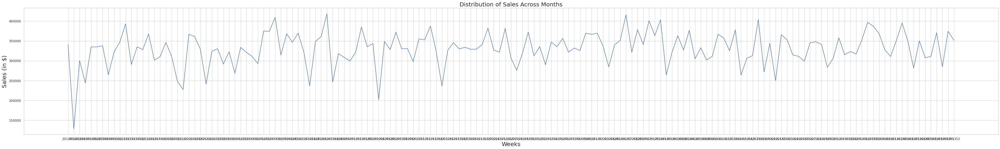

In [0]:
###########Distribution of sales across weeks till 2013#
master_df1=master_df[master_df['Date']<='2013-12-31']
master_df1=master_df1[master_df1['Date']!='2011-01-02']
weekly_df=master_df1.groupby(['Week_no'])['total_amt'].sum().to_frame().reset_index().sort_values(by='Week_no')
weekly_df['Week_no']=weekly_df['Week_no'].astype(str)
fig, ax = plt.subplots()
fig.set_size_inches(60, 8)
plt.plot('Week_no','total_amt',data=weekly_df)
sns.set_style("dark")
plt.xlabel('Weeks',fontsize=20)
plt.ylabel('Sales (in $)',fontsize=20)
plt.title('Distribution of Sales Across Months',fontsize=20)

In [0]:
weekly_df.head(60)

,Week_no,total_amt
0,201101,340779.790
1,201102,128524.760
2,201104,300546.740
3,201105,243907.755
4,201106,334799.530
5,201107,334748.700
6,201108,337970.880
7,201109,264679.545
8,201110,322288.720
9,201111,347151.220


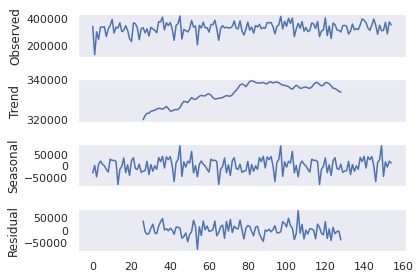

In [0]:
##########Decomposing the time series into trend, seasonality and cycles
from random import randrange
from pandas import Series
from matplotlib import pyplot
from statsmodels.tsa.seasonal import seasonal_decompose
series = weekly_df['total_amt']
result = seasonal_decompose(series, model='additive', freq=52)
result.plot()
pyplot.show()

<b>We need to find the if the time series in stationary
We formulate an hypothesis and check for its stationarity for a significance level of 0.05 using dicky fuller test<br>
NULL: The sales data is not stationary<br>
Aternate: The sales data is stationary

In [0]:
from statsmodels.tsa.stattools import adfuller
from numpy import log
result = adfuller(weekly_df.total_amt.dropna())
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])

ADF Statistic: -5.407760
p-value: 0.000003


By looking at the p value, we reject the NULL hyothesis and it implies we dont need to difference the series as it is already stationary

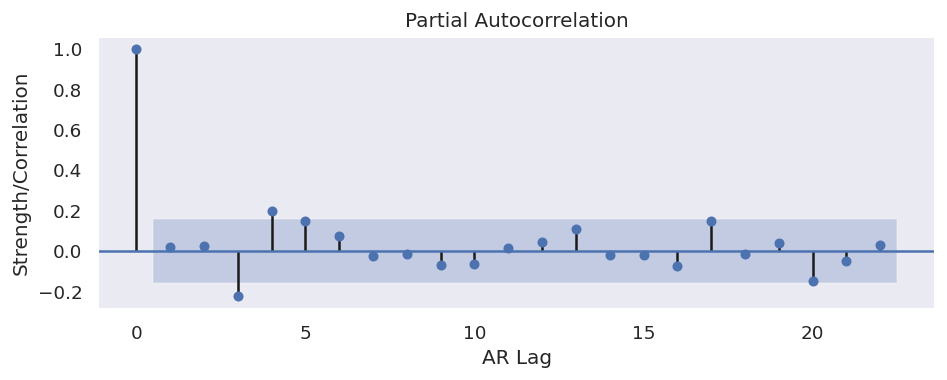

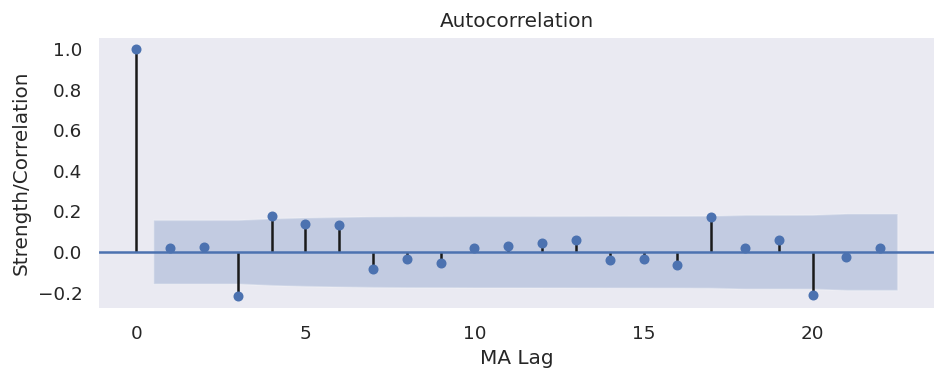

In [0]:
# PACF plot of 1st differenced series
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
plt.rcParams.update({'figure.figsize':(9,3), 'figure.dpi':120})


# fig, axes = plt.subplots(1, 2, sharex=True)
# axes[0].plot(weekly_df.total_amt.diff()); axes[0].set_title('1st Differencing')
# # axes[1].set(ylim=(0,5))
plot_pacf(weekly_df.total_amt.dropna())
plt.xlabel('AR Lag')
plt.ylabel('Strength/Correlation')
plot_acf(weekly_df.total_amt.dropna())
plt.xlabel('MA Lag')
plt.ylabel('Strength/Correlation')


plt.show()

In [0]:
########Fitting the ARIMA model with the obtained parameters from the plots
from statsmodels.tsa.arima_model import ARIMA

# 1,1,2 ARIMA Model
model = ARIMA(weekly_df.total_amt, order=(4,0,3))
model_fit = model.fit(disp=0)
print(model_fit.summary())

                              ARMA Model Results                              
Dep. Variable:              total_amt   No. Observations:                  155
Model:                     ARMA(4, 3)   Log Likelihood               -1861.728
Method:                       css-mle   S.D. of innovations          39730.497
Date:                Wed, 13 May 2020   AIC                           3741.456
Time:                        01:40:11   BIC                           3768.847
Sample:                             0   HQIC                          3752.582
                                                                              
                      coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------
const            3.295e+05   4368.984     75.421      0.000    3.21e+05    3.38e+05
ar.L1.total_amt     0.6297      0.207      3.047      0.003       0.225       1.035
ar.L2.total_amt    -0.0904      

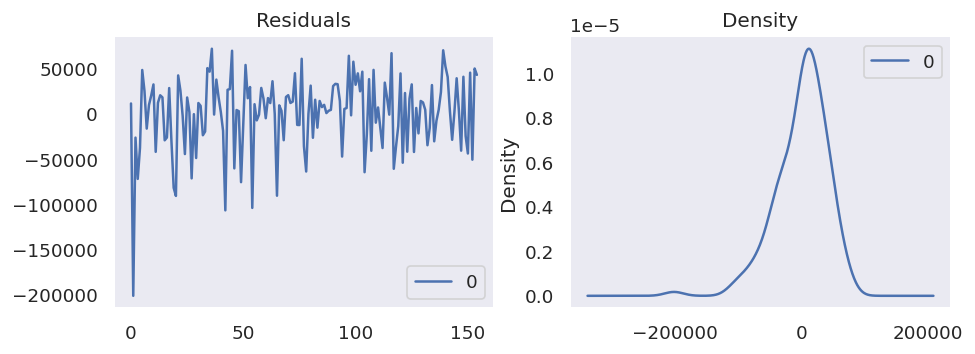

In [0]:
residuals = pd.DataFrame(model_fit.resid)
fig, ax = plt.subplots(1,2)
residuals.plot(title="Residuals", ax=ax[0])
residuals.plot(kind='kde', title='Density', ax=ax[1])
plt.show()

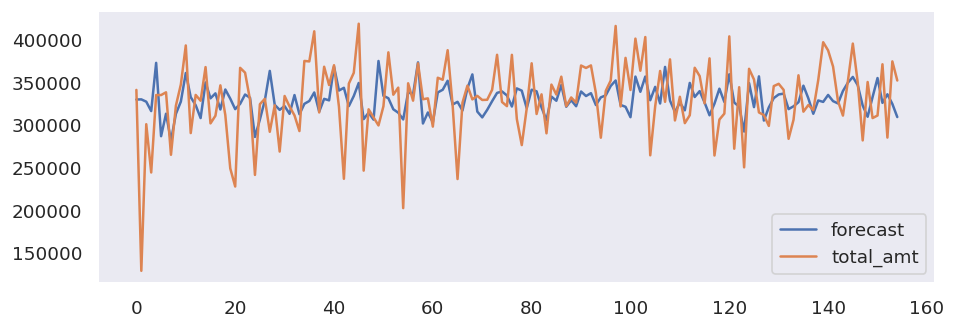

In [0]:
model_fit.plot_predict(dynamic=False)
plt.show()

In [0]:
from statsmodels.tsa.stattools import acf

# Create Training and Testing set
X_train = weekly_df.total_amt[:126]
X_test = weekly_df.total_amt[126:]

                              ARMA Model Results                              
Dep. Variable:              total_amt   No. Observations:                  126
Model:                     ARMA(3, 4)   Log Likelihood               -1514.835
Method:                       css-mle   S.D. of innovations          39394.206
Date:                Wed, 13 May 2020   AIC                           3047.669
Time:                        01:40:16   BIC                           3073.196
Sample:                             0   HQIC                          3058.040
                                                                              
                      coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------
const            3.285e+05   3899.993     84.228      0.000    3.21e+05    3.36e+05
ar.L1.total_amt     0.0595      0.105      0.566      0.572      -0.146       0.265
ar.L2.total_amt    -0.2028      

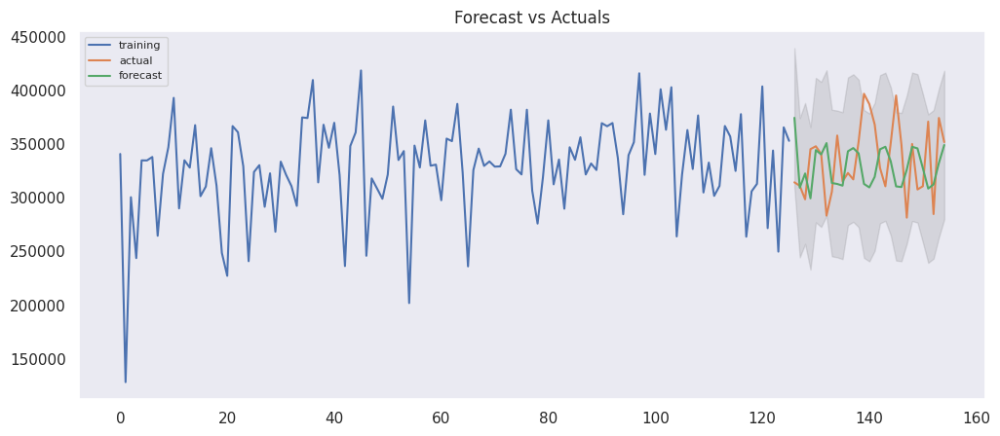

In [0]:

# Build Model

model = ARIMA(X_train, order=(3, 0, 4))  
fitted = model.fit(disp=-1) 
print(fitted.summary())

# Forecast
fc, se, conf = fitted.forecast(29, alpha=0.1)  # 95% conf

# Make as pandas series
fc_series = pd.Series(fc, index=X_test.index)
lower_series = pd.Series(conf[:, 0], index=X_test.index)
upper_series = pd.Series(conf[:, 1], index=X_test.index)

# Plot
plt.figure(figsize=(12,5), dpi=100)
plt.plot(X_train, label='training')
plt.plot(X_test, label='actual')
plt.plot(fc_series, label='forecast')
plt.fill_between(lower_series.index, lower_series, upper_series, 
                 color='k', alpha=.1)
plt.title('Forecast vs Actuals')
plt.legend(loc='upper left', fontsize=8)
plt.show()

In [0]:
############Calculating the MAPE of the model############
pd.DataFrame([fc_series,X_test])
dataset = pd.DataFrame({'test_set': X_test,'forecast': fc_series})
dataset['PE']=(abs(dataset['test_set']-dataset['forecast'])/dataset['test_set'])

In [0]:
print("The mean absolute % error is {}%".format(round(np.mean(np.abs(fc- X_test.values)/np.abs(X_test.values))*100,2)))
print("The mean % error is {}%".format(round(np.mean((fc- X_test.values)/(X_test.values))*100,2)))

The mean absolute % error is 9.76%
The mean % error is -0.82%


In [0]:
X=weekly_df.reset_index()['index']
y=weekly_df['total_amt']

<b>Doing cross validation using TimeSeriesSplit that can take care of the ordering data when splitting it

In [0]:
from sklearn.model_selection import TimeSeriesSplit
tscv = TimeSeriesSplit()
print(tscv)
TimeSeriesSplit(max_train_size=130, n_splits=5)
z=0
for train_index, test_index in tscv.split(X):
  print("TRAIN:", train_index, "TEST:", test_index)
  X_train, X_test = X[train_index], X[test_index]
  y_train, y_test = y[train_index], y[test_index]
  try:
    model = ARIMA(y_train, order=(3, 0, 4))
    fitted = model.fit(disp=-1) 
  except: 
    pass
  fc, se, conf = fitted.forecast(25, alpha=0.1)
  print(fc.shape)
  print(y_test.shape)
  mape=np.mean(np.abs(fc- y_test.values)/np.abs(y_test.values))*100  
  z=(mape+z)/2
  print(z)

print("The average MAPE of the model comes out to be {}".format(round(z,3))+"%")

TimeSeriesSplit(max_train_size=None, n_splits=5)
TRAIN: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29] TEST: [30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50 51 52 53
 54]
(25,)
(25,)
6.663174237642918
TRAIN: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54] TEST: [55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72 73 74 75 76 77 78
 79]
(25,)
(25,)
8.15431299044732
TRAIN: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71
 72 73 74 75 76 77 78 79] TEST: [ 80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97
  98  99 100 101 102 103 104]
(25,)
(25,)
7.63126256638326
TRAIN: [  0   1   2   3   4   5   6   7   8   9  10  11  1

/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/tsatools.py:668: RuntimeWarning:

overflow encountered in exp

/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/tsatools.py:668: RuntimeWarning:

invalid value encountered in true_divide

/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/tsatools.py:669: RuntimeWarning:

overflow encountered in exp

/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/tsatools.py:669: RuntimeWarning:

invalid value encountered in true_divide



(25,)
(25,)
9.27189541518129
TRAIN: [  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129] TEST: [130 131 132 133 134 135 136 137 138 139 140 141 142 143 144 145 146 147
 148 149 150 151 152 153 154]
(25,)
(25,)
8.912090538315422
The average MAPE of the model comes out to be 8.912%


In [0]:
####installing pmdarima for paramter tuning and estimation###
!pip install pmdarima

     |████████████████████████████████| 1.5MB 3.4MB/s 


In [0]:
# Create Training and Testing set
X_train = weekly_df.total_amt[:126]
X_test = weekly_df.total_amt[126:]
X_train

0      340779.790
1      128524.760
2      300546.740
3      243907.755
4      334799.530
          ...    
121    271790.220
122    343969.925
123    249924.480
124    365546.155
125    352984.515
Name: total_amt, Length: 126, dtype: float64

In [0]:
########The autoarima model takes the seasonal component (Seasonal=True) into account and finds the best parameters
import pmdarima as pm
smodel = pm.auto_arima(X_train, start_p=1, start_q=1,
                         test='adf',
                         max_p=3, max_q=3, m=52,
                         start_P=0, seasonal=True,
                         d=None, D=1, trace=True,
                         error_action='ignore',  
                         suppress_warnings=True, 
                         stepwise=True)

smodel.summary()

Performing stepwise search to minimize aic
Fit ARIMA(1,1,1)x(0,1,1,52) [intercept=True]; AIC=nan, BIC=nan, Time=nan seconds
Fit ARIMA(0,1,0)x(0,1,0,52) [intercept=True]; AIC=1874.011, BIC=1878.592, Time=0.378 seconds
Fit ARIMA(1,1,0)x(1,1,0,52) [intercept=True]; AIC=1824.251, BIC=1833.413, Time=3.538 seconds
Fit ARIMA(0,1,1)x(0,1,1,52) [intercept=True]; AIC=nan, BIC=nan, Time=nan seconds
Fit ARIMA(0,1,0)x(0,1,0,52) [intercept=False]; AIC=1885.167, BIC=1887.457, Time=0.291 seconds
Fit ARIMA(1,1,0)x(0,1,0,52) [intercept=True]; AIC=1836.528, BIC=1843.399, Time=0.473 seconds
Fit ARIMA(1,1,0)x(2,1,0,52) [intercept=True]; AIC=nan, BIC=nan, Time=nan seconds
Fit ARIMA(1,1,0)x(1,1,1,52) [intercept=True]; AIC=nan, BIC=nan, Time=nan seconds
Fit ARIMA(1,1,0)x(0,1,1,52) [intercept=True]; AIC=nan, BIC=nan, Time=nan seconds
Fit ARIMA(1,1,0)x(2,1,1,52) [intercept=True]; AIC=nan, BIC=nan, Time=nan seconds
Fit ARIMA(0,1,0)x(1,1,0,52) [intercept=True]; AIC=1854.608, BIC=1861.479, Time=3.201 seconds
Fit A

<class 'statsmodels.iolib.summary.Summary'>
"""
                                 Statespace Model Results                                 
==========================================================================================
Dep. Variable:                                  y   No. Observations:                  126
Model:             SARIMAX(3, 1, 0)x(1, 1, 0, 52)   Log Likelihood                -903.101
Date:                            Wed, 13 May 2020   AIC                           1818.201
Time:                                    01:41:24   BIC                           1831.944
Sample:                                         0   HQIC                          1823.678
                                            - 126                                         
Covariance Type:                              opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept  -3005.4252   8069.823     -0.372      0.710   -1.88e+04    1.28e+04
ar.L1         -0.6340      0.140     -4.538      0.000      -0.908      -0.360
ar.L2         -0.2787      0.095     -2.941      0.003      -0.464      -0.093
ar.L3         -0.3020      0.120     -2.512      0.012      -0.538      -0.066
ar.S.L52      -0.3764      0.041     -9.149      0.000      -0.457      -0.296
sigma2      2.654e+09      0.093   2.87e+10      0.000    2.65e+09    2.65e+09
===================================================================================
Ljung-Box (Q):                       27.01   Jarque-Bera (JB):                99.77
Prob(Q):                              0.94   Prob(JB):                         0.00
Heteroskedasticity (H):               1.11   Skew:                            -1.63
Prob(H) (two-sided):                  0.80   Kurtosis:                         7.71
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
[2] Covariance matrix is singular or near-singular, with condition number 3.75e+25. Standard errors may be unstable.
"""

In [0]:
# data = X_train
# obtained model configurations
my_order = (3, 1, 0) 
# my_seasonal_order = (1, 1, 0, 52)
import statsmodels.api as sm
# define model
model = sm.tsa.statespace.SARIMAX(endog=X_train, order=my_order,seasonal_order=(1,1,0,52),enforce_stationarity=True,enforce_invertibility=True)
# ,seasonal_order=my_seasonal_order)

In [0]:
res = model.fit(disp=False)
print(res.summary())

                                 Statespace Model Results                                 
Dep. Variable:                          total_amt   No. Observations:                  126
Model:             SARIMAX(3, 1, 0)x(1, 1, 0, 52)   Log Likelihood                -903.551
Date:                            Wed, 13 May 2020   AIC                           1817.101
Time:                                    01:41:49   BIC                           1828.554
Sample:                                         0   HQIC                          1821.665
                                            - 126                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.6290      0.131     -4.811      0.000      -0.885      -0.373
ar.L2         -0.2707      0.079   

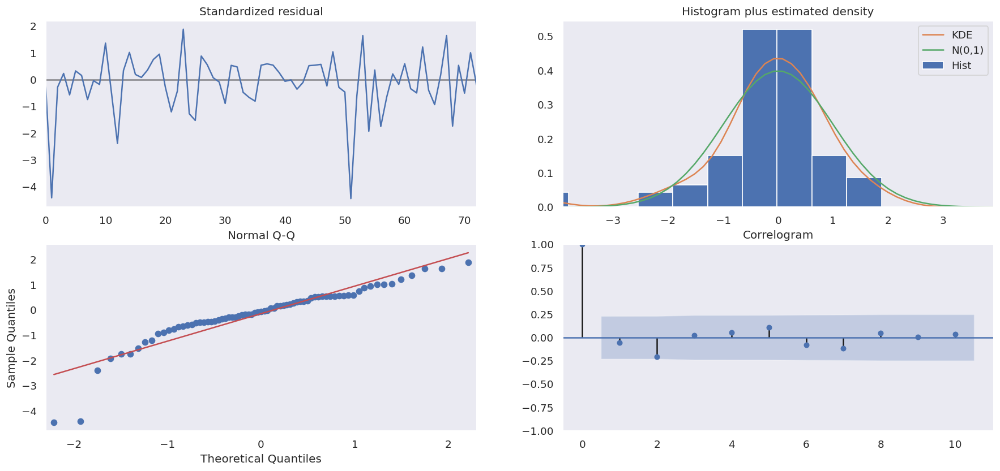

In [0]:
##plots to analyze additional results
res.plot_diagnostics(figsize=(18, 8))
plt.show()

0.10741269646733836

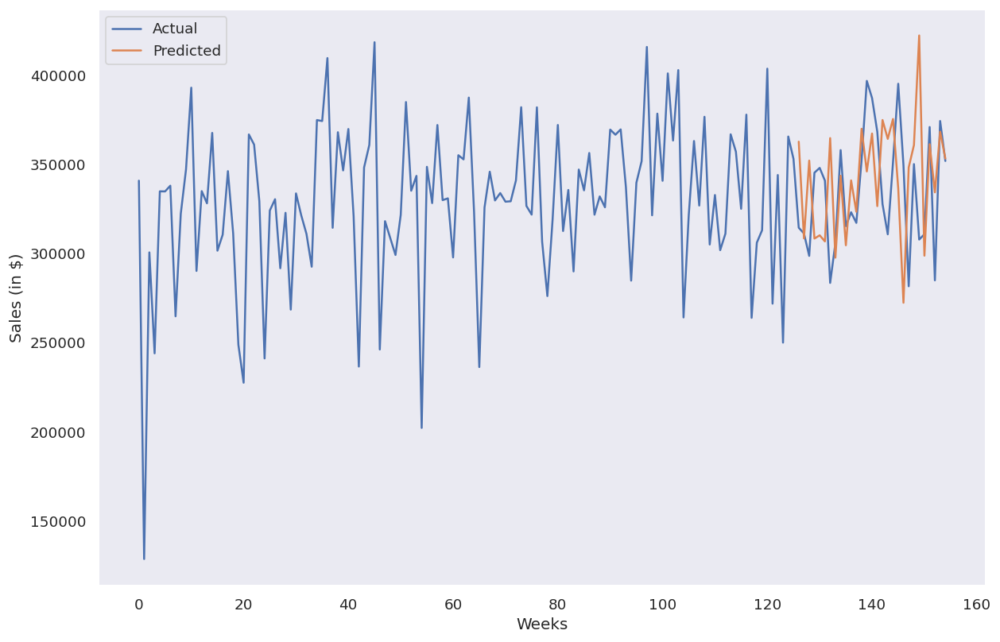

In [0]:
########Calculating the MAPE for single model run
X = res.predict(start = 126, end= 154, dynamic= True)
df = pd.DataFrame({'Actual': weekly_df.total_amt, 'Predicted': X})
df[['Actual', 'Predicted']].plot(figsize=(12, 8))
plt.xlabel('Weeks')
plt.ylabel('Sales (in $)')
np.mean(abs(df.dropna()['Actual']-df.dropna()['Predicted'])/df.dropna()['Actual'])

<b>Cross Validation run for testing the robusticity of a model

In [0]:
# Create Training and Testing set
X=weekly_df['total_amt']

In [0]:
from sklearn.model_selection import TimeSeriesSplit
tscv = TimeSeriesSplit()
print(tscv)
TimeSeriesSplit(max_train_size=130, n_splits=5)
z=[]
for train_index, test_index in tscv.split(X):
  print("TRAIN:", train_index, "TEST:", test_index)
  X_train, X_test = X[train_index], X[test_index]
  y_train, y_test = y[train_index], y[test_index]
  try:
    smodel = pm.auto_arima(y_train, start_p=1, start_q=1,
                         test='adf',
                         max_p=3, max_q=3, m=52,
                         start_P=0, seasonal=True,
                         d=None, D=1, trace=True,
                         error_action='ignore',  
                         suppress_warnings=True, 
                         stepwise=True)
    fitted = smodel.fit(disp=-1) 
  except: 
    pass
    fc, se, conf = fitted.forecast(25, alpha=0.1)
    # fc = fitted.forecast(25, alpha=0.1)
    # print(fc.shape)
    print(y_test.shape)
    mape=np.mean(np.abs(fc- y_test.values)/np.abs(y_test.values))*100  
    z.append(mape)
    print(z)

x=sum(z)/len(z)
print("The average MAPE of the model comes out to be {}".format(round(x,3))+"%")

TimeSeriesSplit(max_train_size=None, n_splits=5)
TRAIN: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29] TEST: [30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50 51 52 53
 54]
(25,)
[12.378364011701846]
TRAIN: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54] TEST: [55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72 73 74 75 76 77 78
 79]
(25,)
[12.378364011701846, 7.025874327172596]
TRAIN: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71
 72 73 74 75 76 77 78 79] TEST: [ 80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97
  98  99 100 101 102 103 104]
Performing stepwise search to minimize aic
Fit ARIMA(1,1,1)x(0,1,1,52) [i

**Problem3 - Customer Product Affinity**


In [0]:
master_df.groupby(['cust_id'])['prod_subcat'].nunique().to_frame()

,prod_subcat
cust_id,
266783,2
266784,3
266785,4
266788,3
266794,7
...,...
275257,4
275261,3
275262,2


In [0]:
#########Find the share of total amount spent on each sub category by each customer
prod_aff=master_df.groupby(['cust_id','prod_subcat'])['total_amt'].sum().to_frame().reset_index()
prod_aff=prod_aff.pivot(index='cust_id',columns='prod_subcat',values='total_amt')
prod_aff.fillna(0,inplace=True)
prod_aff=pd.merge(prod_aff,df3_clustering1[['cust_id','Cluster','transaction_id','total_amt']],how='inner',on=['cust_id','cust_id'])
prod_aff

,cust_id,Academic,Audio and video,Bath,Cameras,Children,Comics,Computers,DIY,Fiction,Furnishing,Kids,Kitchen,Mens,Mobiles,Non-Fiction,Personal Appliances,Tools,Women,Cluster,transaction_id,total_amt
0,266783,0.00,0.000,0.0,0.00,0.000,0.00,0.0,0.0,0.00,0.000,0.00,0.00,7130.565,0.0,1845.350,0.00,0.00,0.000,2,4,8952.710
1,266784,0.00,0.000,0.0,0.00,0.000,0.00,0.0,0.0,972.40,0.000,0.00,0.00,0.000,442.0,4279.665,0.00,0.00,0.000,2,3,5694.065
2,266785,0.00,0.000,0.0,0.00,5066.425,0.00,0.0,0.0,0.00,0.000,9686.43,6550.44,6499.610,0.0,0.000,0.00,0.00,0.000,0,7,28442.700
3,266788,0.00,0.000,0.0,0.00,0.000,0.00,0.0,0.0,1367.99,0.000,1927.12,0.00,2797.860,0.0,0.000,0.00,0.00,0.000,2,4,6092.970
4,266794,3964.74,1049.750,0.0,0.00,4415.580,0.00,0.0,0.0,0.00,0.000,4099.55,0.00,2948.140,0.0,0.000,4610.06,0.00,7225.595,0,10,27406.210
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5464,275257,0.00,1433.185,0.0,0.00,3484.065,0.00,0.0,0.0,0.00,1150.305,0.00,0.00,6550.440,0.0,0.000,0.00,0.00,0.000,1,4,13725.205
5465,275261,0.00,0.000,0.0,0.00,442.000,2857.53,0.0,0.0,0.00,0.000,0.00,0.00,0.000,0.0,0.000,0.00,0.00,405.535,2,3,3705.065
5466,275262,0.00,0.000,0.0,1750.32,0.000,0.00,0.0,0.0,0.00,0.000,0.00,0.00,3328.260,0.0,0.000,0.00,0.00,0.000,2,2,5078.580
5467,275264,0.00,0.000,0.0,0.00,0.000,0.00,0.0,0.0,0.00,0.000,0.00,0.00,0.000,0.0,1221.025,0.00,2594.54,0.000,2,2,3815.565


In [0]:
## Find the top1, top2 and top3 sub category for each customer
df_1=prod_aff.drop(columns=['cust_id','Cluster','transaction_id','total_amt'],axis=1)
result1=prod_aff[['cust_id','Cluster']]
# df_1.drop(columns=['max1','max2','max3'],axis=1,inplace=True)
len(df_1.columns)
df_1['id'] = range(len(df_1))
df_1 = df_1.set_index('id')
nlargest = 3
df_1.head()
order = np.argsort(-df_1.values, axis=1)[:, :nlargest]
result = pd.DataFrame(df_1.columns[order], 
                      columns=['top{}'.format(i) for i in range(1, nlargest+1)],
                      index=df_1.index)
prod_aff_cluster=pd.concat([result1,result],axis=1)
prod_aff_cluster.head()
# prod_aff_cluster.to_csv("y.csv")

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:10: DeprecationWarning:

Support for multi-dimensional indexing (e.g. `index[:, None]`) on an Index is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.



,cust_id,Cluster,top1,top2,top3
0,266783,2,Mens,Non-Fiction,Academic
1,266784,2,Non-Fiction,Fiction,Mobiles
2,266785,0,Kids,Kitchen,Mens
3,266788,2,Mens,Kids,Fiction
4,266794,0,Women,Personal Appliances,Children


In [0]:
# prod_aff['max1'] = prod_aff.drop(columns=['cust_id','Cluster']).T.apply(lambda x: x.nlargest(1).idxmin())
# prod_aff['max2'] = prod_aff.drop(columns=['cust_id','Cluster','max1']).T.apply(lambda x: x.nlargest(2).idxmin())
# prod_aff['max3'] = prod_aff.drop(columns=['cust_id','Cluster','max1','max2']).T.apply(lambda x: x.nlargest(3).idxmin())
prod_aff

,cust_id,Academic,Audio and video,Bath,Cameras,Children,Comics,Computers,DIY,Fiction,Furnishing,Kids,Kitchen,Mens,Mobiles,Non-Fiction,Personal Appliances,Tools,Women,Cluster,transaction_id,total_amt
0,266783,0.00,0.000,0.0,0.00,0.000,0.00,0.0,0.0,0.00,0.000,0.00,0.00,7130.565,0.0,1845.350,0.00,0.00,0.000,2,4,8952.710
1,266784,0.00,0.000,0.0,0.00,0.000,0.00,0.0,0.0,972.40,0.000,0.00,0.00,0.000,442.0,4279.665,0.00,0.00,0.000,2,3,5694.065
2,266785,0.00,0.000,0.0,0.00,5066.425,0.00,0.0,0.0,0.00,0.000,9686.43,6550.44,6499.610,0.0,0.000,0.00,0.00,0.000,0,7,28442.700
3,266788,0.00,0.000,0.0,0.00,0.000,0.00,0.0,0.0,1367.99,0.000,1927.12,0.00,2797.860,0.0,0.000,0.00,0.00,0.000,2,4,6092.970
4,266794,3964.74,1049.750,0.0,0.00,4415.580,0.00,0.0,0.0,0.00,0.000,4099.55,0.00,2948.140,0.0,0.000,4610.06,0.00,7225.595,0,10,27406.210
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5464,275257,0.00,1433.185,0.0,0.00,3484.065,0.00,0.0,0.0,0.00,1150.305,0.00,0.00,6550.440,0.0,0.000,0.00,0.00,0.000,1,4,13725.205
5465,275261,0.00,0.000,0.0,0.00,442.000,2857.53,0.0,0.0,0.00,0.000,0.00,0.00,0.000,0.0,0.000,0.00,0.00,405.535,2,3,3705.065
5466,275262,0.00,0.000,0.0,1750.32,0.000,0.00,0.0,0.0,0.00,0.000,0.00,0.00,3328.260,0.0,0.000,0.00,0.00,0.000,2,2,5078.580
5467,275264,0.00,0.000,0.0,0.00,0.000,0.00,0.0,0.0,0.00,0.000,0.00,0.00,0.000,0.0,1221.025,0.00,2594.54,0.000,2,2,3815.565


In [0]:
#Filtering the customers according to the cluster they belong to#######
prod_aff_cluster.head()
prod_aff_cluster_0=prod_aff_cluster[prod_aff_cluster['Cluster']==0]
prod_aff_cluster_1=prod_aff_cluster[prod_aff_cluster['Cluster']==1]
prod_aff_cluster_2=prod_aff_cluster[prod_aff_cluster['Cluster']==2]

<b> Analysing product suggestions according to different clusters </b>

In [0]:
# # Rectifiying max 2 and max 3 error - code by Gopu Panda boy 
# df_1=prod_aff.drop(columns=['cust_id','Cluster','total_amt','transaction_id'],axis=1)
# # df_1.drop(columns=['max1','max2','max3'],axis=1,inplace=True)
# len(df_1.columns)
# df_1['id'] = range(len(df_1))
# df_1 = df_1.set_index('id')
# nlargest = 3
# df_1.head()
# order = np.argsort(-df_1.values, axis=1)[:, :nlargest]
# result = pd.DataFrame(df_1.columns[order], 
#                       columns=['top{}'.format(i) for i in range(1, nlargest+1)],
#                       index=df_1.index)
# result
# prod_aff_cluster=pd.concat([result1,result],axis=1)
# prod_aff_cluster.head()

In [0]:
##########User defined funtion to concatenate all the top1,2,3 products to get the purchase chain
def product_affinity(x,y):
  """
  :param - x : a dictionary to store product affinity information
  :param - y : a datframe containing top three max sequences
  :returns : x
  
  """
  for i,j,k in zip(list(y['top1']),list(y['top2']),list(y['top3'])):
    if i + " " + j + " " + k in x.keys():
      x[i + " " + j + " " + k]+=1
    else:
      x[i + " " + j + " " + k]=1
  x=sorted(x.items(),key=lambda item:item[1], reverse=True)
  x=pd.DataFrame(x[0:20])
  x.rename(columns={1:'#Customers', 0:'most prominent sequence'},inplace=True)
  return x

<B> Cluster 0 </B>

Text(0.5, 1.0, 'Product sequence suggestions for cluster 0 population')

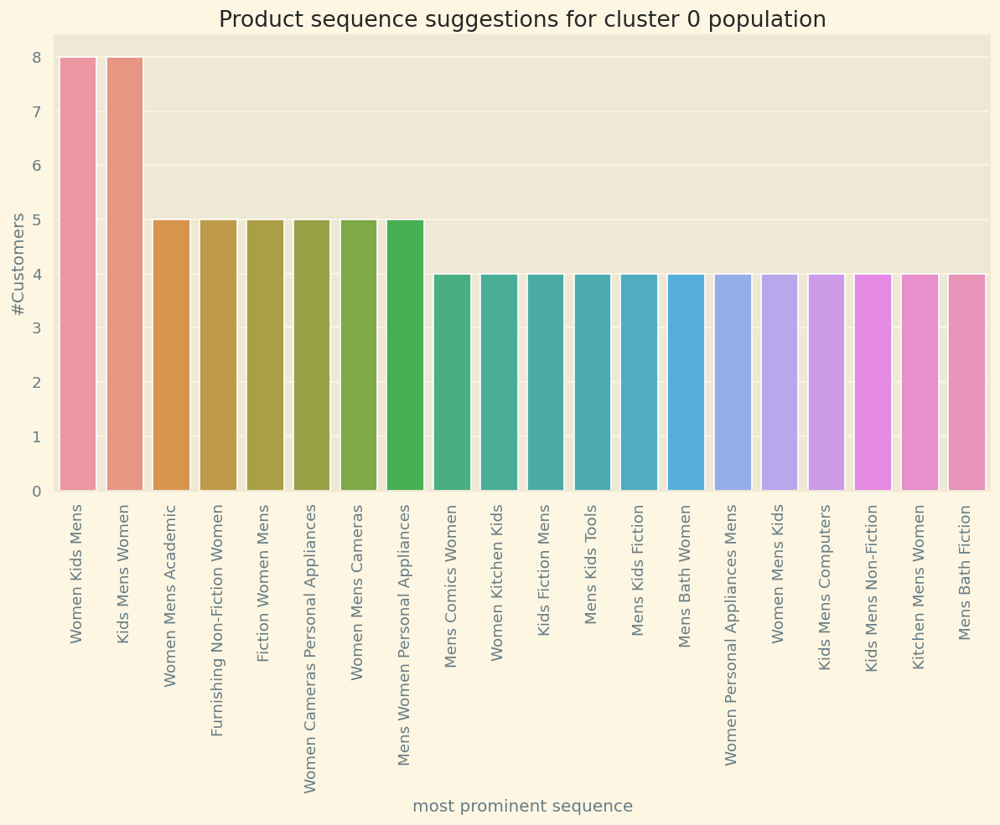

In [0]:
plt.figure(figsize=(12,6))
suggestions_0={}
suggestions_0=product_affinity(x=suggestions_0,y=prod_aff_cluster_0)
enable_plotly_in_cell()
g=sns.barplot(x='most prominent sequence',y='#Customers',data=suggestions_0)
plt.style.use('Solarize_Light2')
g.set_xticklabels(g.get_xticklabels(),rotation=90)
plt.title('Product sequence suggestions for cluster 0 population')

<B> Cluster 1 </B>

In [0]:
suggestions_0.head()

,most prominent sequence,#Customers
0,Women Kids Mens,8
1,Kids Mens Women,8
2,Women Mens Academic,5
3,Furnishing Non-Fiction Women,5
4,Fiction Women Mens,5


Text(0.5, 1.0, 'Product sequence suggestions for cluster 1 population')

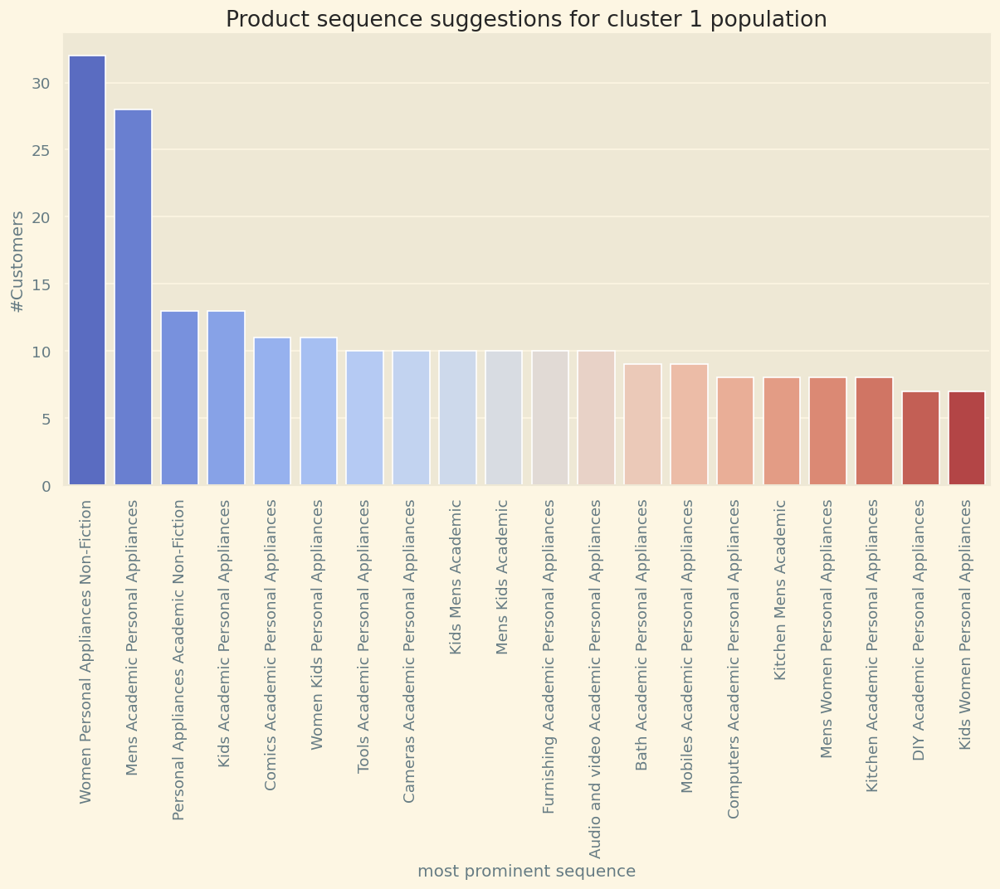

In [0]:
plt.figure(figsize=(12,6))
suggestions_1={}
suggestions_1=product_affinity(x=suggestions_1,y=prod_aff_cluster_1)
enable_plotly_in_cell()
g=sns.barplot(x='most prominent sequence',y='#Customers',data=suggestions_1,palette='coolwarm')
plt.style.use('Solarize_Light2')
g.set_xticklabels(g.get_xticklabels(),rotation=90)
plt.title('Product sequence suggestions for cluster 1 population')

<b> Cluster 2 </b>

Text(0.5, 1.0, 'Product sequence suggestions for cluster 2 population')

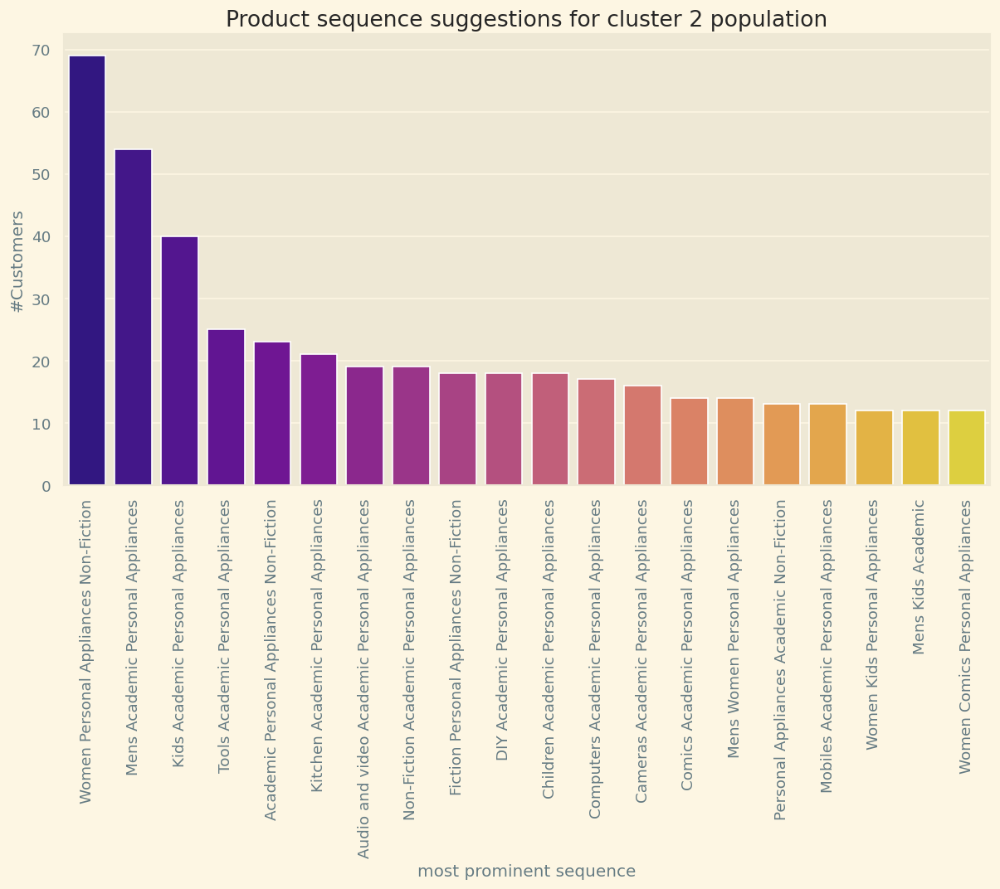

In [0]:
plt.figure(figsize=(12,6))
suggestions_2={}
suggestions_2=product_affinity(x=suggestions_2,y=prod_aff_cluster_2)
enable_plotly_in_cell()
g=sns.barplot(x='most prominent sequence',y='#Customers',data=suggestions_2,palette='plasma')
plt.style.use('Solarize_Light2')
g.set_xticklabels(g.get_xticklabels(),rotation=90)
plt.title('Product sequence suggestions for cluster 2 population')

In [0]:
prod_aff_cluster['concat']=prod_aff_cluster['top1']+"-"+prod_aff_cluster['top2']+"-"+prod_aff_cluster['top3']

In [0]:
final=pd.merge(prod_aff,prod_aff_cluster,on=['cust_id','cust_id'],how='left')
final.head()

,cust_id,Academic,Audio and video,Bath,Cameras,Children,Comics,Computers,DIY,Fiction,Furnishing,Kids,Kitchen,Mens,Mobiles,Non-Fiction,Personal Appliances,Tools,Women,Cluster_x,transaction_id,total_amt,Cluster_y,top1,top2,top3,concat
0,266783,0.00,0.00,0.0,0.0,0.000,0.0,0.0,0.0,0.00,0.0,0.00,0.00,7130.565,0.0,1845.350,0.00,0.0,0.000,2,4,8952.710,2,Mens,Non-Fiction,Academic,Mens-Non-Fiction-Academic
1,266784,0.00,0.00,0.0,0.0,0.000,0.0,0.0,0.0,972.40,0.0,0.00,0.00,0.000,442.0,4279.665,0.00,0.0,0.000,2,3,5694.065,2,Non-Fiction,Fiction,Mobiles,Non-Fiction-Fiction-Mobiles
2,266785,0.00,0.00,0.0,0.0,5066.425,0.0,0.0,0.0,0.00,0.0,9686.43,6550.44,6499.610,0.0,0.000,0.00,0.0,0.000,0,7,28442.700,0,Kids,Kitchen,Mens,Kids-Kitchen-Mens
3,266788,0.00,0.00,0.0,0.0,0.000,0.0,0.0,0.0,1367.99,0.0,1927.12,0.00,2797.860,0.0,0.000,0.00,0.0,0.000,2,4,6092.970,2,Mens,Kids,Fiction,Mens-Kids-Fiction
4,266794,3964.74,1049.75,0.0,0.0,4415.580,0.0,0.0,0.0,0.00,0.0,4099.55,0.00,2948.140,0.0,0.000,4610.06,0.0,7225.595,0,10,27406.210,0,Women,Personal Appliances,Children,Women-Personal Appliances-Children


In [0]:
#######To check if the clusters are different using ks sample test. Rejecting the hypothesis confirms that they are different
from scipy import stats
print(stats.ks_2samp(np.array(final[final['Cluster_x']==0]['transaction_id']),np.array(final[final['Cluster_x']==1]['transaction_id'])))
print(stats.ks_2samp(np.array(final[final['Cluster_x']==1]['transaction_id']),np.array(final[final['Cluster_x']==2]['transaction_id'])))
print(stats.ks_2samp(np.array(final[final['Cluster_x']==0]['transaction_id']),np.array(final[final['Cluster_x']==2]['transaction_id'])))

Ks_2sampResult(statistic=0.9046225863077824, pvalue=0.0)
Ks_2sampResult(statistic=0.1018242256135454, pvalue=1.0806053496459356e-08)
Ks_2sampResult(statistic=0.886911414645657, pvalue=8.420046881951748e-10)


In [0]:
import sys
sys.version

'3.6.9 (default, Apr 18 2020, 01:56:04) \n[GCC 8.4.0]'